In [2]:
import plotly.express as px
import matplotlib.pyplot as plt
import pandas as pd 
import numpy as np 

# for price API
from urllib.request import urlopen
import certifi
import json

# Shiny
from shiny import App, ui, render
import shinywidgets
import mpld3

# Image scraping
import requests
from PIL import Image 
from io import BytesIO

# SQL
import pymysql
from sqlalchemy import create_engine
import getpass
from sqlalchemy import text

In [45]:
# password = getpass. getpass("Enter Password:")

In [3]:
# Wheat price API

fmp_api_key = pd.read_table(r'../../FMP_api_key')
fmp_api_key = fmp_api_key['key'][0]

def get_jsonparsed_data(url):
    response = urlopen(url, cafile=certifi.where())
    data = response.read().decode("utf-8")
    return json.loads(data)

url = ("https://financialmodelingprep.com/api/v3/quote/KEUSX?apikey="+fmp_api_key)

keusx_dict = get_jsonparsed_data(url)

keusx_price = keusx_dict[0]['price']

C:\Users\matth\AppData\Local\Temp\ipykernel_25120\1015205172.py:7: DeprecationWarning: cafile, capath and cadefault are deprecated, use a custom context instead.
  response = urlopen(url, cafile=certifi.where())


In [4]:
# Flag dictionary

# Create and update flag dictionary

import requests
import json

url = "https://flagcdn.com/en/codes.json"  

try:
    response = requests.get(url)
    response.raise_for_status()  
    json_data = response.json()
finally:
    pass

flag_dict = {v: k for k, v in json_data.items()}

# Correct country names in line with SQL

flag_dict['Brunei Darussalam'] = flag_dict["Brunei"]
flag_dict['Cabo Verde'] = flag_dict["Cape Verde"]
flag_dict['Congo, Dem. Rep.'] = flag_dict["DR Congo"]
flag_dict['Congo, Rep.'] = flag_dict["Republic of the Congo"]
flag_dict["Cote d'Ivoire"] = flag_dict["Côte d'Ivoire (Ivory Coast)"]
flag_dict['Egypt, Arab Rep.'] = flag_dict["Egypt"]
flag_dict['Micronesia, Fed. Sts.'] = flag_dict["Micronesia"]
flag_dict['Gambia, The'] = flag_dict["Gambia"]
flag_dict['Bahamas, The'] = flag_dict["Bahamas"]
flag_dict['Hong Kong SAR, China'] = flag_dict["Hong Kong"]
flag_dict['Iran, Islamic Rep.'] = flag_dict["Iran"]
flag_dict['Kyrgyz Republic'] = flag_dict["Kyrgyzstan"]
flag_dict['St. Kitts and Nevis'] = flag_dict["Saint Kitts and Nevis"]
flag_dict["Korea, Dem. People's Rep."] = flag_dict["North Korea"]
flag_dict['Korea, Rep.'] = flag_dict["South Korea"]
flag_dict['Lao PDR'] = flag_dict["Laos"]
flag_dict['Russian Federation'] = flag_dict["Russia"]
flag_dict['St. Martin (French part)'] = flag_dict["Saint Martin"]
flag_dict['St. Lucia'] = flag_dict["Saint Lucia"]
flag_dict['Macao SAR'] = flag_dict["Macau"]
flag_dict['Slovak Republic'] = flag_dict["Slovakia"]
flag_dict['Sao Tome and Principe'] = flag_dict["São Tomé and Príncipe"]
flag_dict['Syrian Arab Republic'] = flag_dict["Syria"]
flag_dict['Viet Name'] = flag_dict["Vietnam"]
flag_dict['Venezuela, RB'] = flag_dict["Venezuela"]
flag_dict['Yemen, Rep.'] = flag_dict["Yemen"]
flag_dict['St. Vincent and the Grenadines'] =flag_dict["Saint Vincent and the Grenadines"]

flag_dict.pop("Brunei")
flag_dict.pop("Cape Verde")
flag_dict.pop("DR Congo")
flag_dict.pop("Republic of the Congo")
flag_dict.pop("Côte d'Ivoire (Ivory Coast)")
flag_dict.pop("Egypt")
flag_dict.pop("Micronesia")
flag_dict.pop("Gambia")
flag_dict.pop("Bahamas")
flag_dict.pop("Hong Kong")
flag_dict.pop("Iran")
flag_dict.pop("Kyrgyzstan")
flag_dict.pop("Saint Kitts and Nevis")
flag_dict.pop("North Korea")
flag_dict.pop("South Korea")
flag_dict.pop("Laos")
flag_dict.pop("Russia")
flag_dict.pop("Saint Martin")
flag_dict.pop("Saint Lucia")
flag_dict.pop("Macau")
flag_dict.pop("Slovakia")
flag_dict.pop("São Tomé and Príncipe")
flag_dict.pop("Syria")
flag_dict.pop("Vietnam")
flag_dict.pop("Venezuela")
flag_dict.pop("Yemen")
flag_dict.pop("Saint Vincent and the Grenadines");

In [46]:
# Create SQL engine and load top 10 grain producers for last 10 years
bd = "grain_dash"
connection_string = 'mysql+pymysql://root:' + password + '@localhost/'+bd
engine = create_engine(connection_string)
engine

with engine.connect() as connection:
    query = text('SELECT country AS Country, ROUND(AVG(value),2) AS Average_wheat_produced FROM grain_dash.wheat_production WHERE year > 2014 GROUP BY country ORDER BY Average_wheat_produced DESC LIMIT 10')
    result = connection.execute(query)
    top10_df = pd.DataFrame(result.all())

top10 = list(top10_df['Country'])

In [103]:
# WTO data
with engine.connect() as connection:
    query = text('SELECT * FROM wto_status')
    result = connection.execute(query)
    wto_df = pd.DataFrame(result.all())

In [113]:
# Container data
with engine.connect() as connection:
    query = text('SELECT country AS Country, ROUND(AVG(value),-3) AS Average_container_traffic FROM grain_dash.container WHERE year > 2014 GROUP BY country ORDER BY Average_container_traffic DESC LIMIT 200')
    result = connection.execute(query)
    container_df = pd.DataFrame(result.all())

In [104]:
# Yield data
with engine.connect() as connection:
    query = text('SELECT country AS Country, ROUND(AVG(value),-3) AS Average_yield FROM grain_dash.wheat_yield WHERE year > 2014 GROUP BY country ORDER BY Average_yield DESC LIMIT 100')
    result = connection.execute(query)
    yield_df = pd.DataFrame(result.all())


In [105]:
# Climate risk data
with engine.connect() as connection:
    query = text('SELECT * FROM climate')
    result = connection.execute(query)
    climate_df = pd.DataFrame(result.all())

In [65]:
# Doing Business data
with engine.connect() as connection:
    query = text('SELECT country, db_rank FROM doing_business')
    result = connection.execute(query)
    db_df = pd.DataFrame(result.all())

In [14]:
# ordinal function
ordinal = lambda n: "%d%s" % (n,"tsnrhtdd"[(n//10%10!=1)*(n%10<4)*n%10::4])

In [15]:
# Set countries/pages

p1 = top10[0]
p2 = top10[1]
p3 = top10[2]
p4 = top10[3]
p5 = top10[4]
p6 = top10[5]
p7 = top10[6]
p8 = top10[7]
p9 = top10[8]
p10 = top10[9]

# Summary

## Column {width=5%}

In [192]:
#| content: valuebox
#| title: --
#| icon: flag
#| color: light
print("Country")

Country


In [178]:
#| content: valuebox
#| title: --
#| icon: globe-europe-africa
#| color: light
print("Global wheat production rank")

Global wheat production rank


In [176]:
#| content: valuebox
#| title: --
#| icon: globe
#| color: light
print("WTO member status")

WTO member status


In [179]:
#| content: valuebox
#| title: --
#| icon: sun
#| color: light
print("Climate risk ranking")

Climate risk ranking


In [173]:
#| content: valuebox
#| title: --
#| icon: truck
#| color: light
print("Container traffic")

Container traffic


In [171]:
#| content: valuebox
#| title: --
#| icon: flower
#| color: light
print("Wheat yield g/hectare")

Wheat yield g/hectare


In [172]:
#| content: valuebox
#| title: --
#| icon: building-add
#| color: light
print("Ease of doing business")

Ease of doing business


## Column {width=7%}

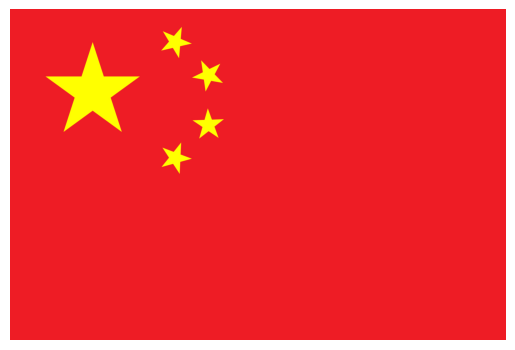

In [180]:
url = f'https://flagcdn.com/w2560/{flag_dict[p1]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [195]:
#| content: valuebox
#| title: _
#| icon: 1-square-fill
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p1}')+1)

'1st'

In [182]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p1].iloc[0])

{'value': 'Member'}

In [183]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p1].iloc[0])))

{'value': '33rd'}

In [184]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p1].iloc[0])/1000}k")

{'value': '231135.0k'}

In [185]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p1].iloc[0])/1000}kg")

{'value': '56.0kg'}

In [186]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p1].iloc[0])))

{'value': '32nd'}

## Column {width=7%}

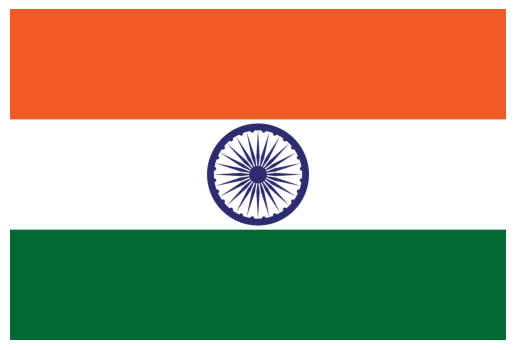

In [218]:
url = f'https://flagcdn.com/w2560/{flag_dict[p2]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [205]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: 2-square-fill
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p2}')+1)

'2nd'

In [197]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p2].iloc[0])

{'value': 'Member'}

In [198]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p2].iloc[0])))

{'value': '5th'}

In [199]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p2].iloc[0])/1000}k")

{'value': '16213.0k'}

In [200]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p2].iloc[0])/1000}kg")

{'value': '33.0kg'}

In [201]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p2].iloc[0])))

{'value': '62nd'}

## Column {width=7%}

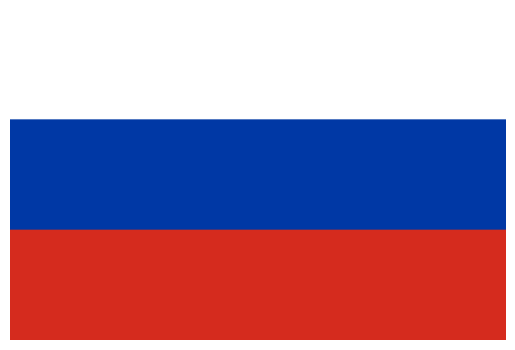

In [202]:
url = f'https://flagcdn.com/w2560/{flag_dict[p3]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [204]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: 3-square-fill
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p3}')+1)

'3rd'

In [206]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p3].iloc[0])

{'value': 'Member'}

In [207]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p3].iloc[0])))

{'value': '79th'}

In [208]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p3].iloc[0])/1000}k")

{'value': '4477.0k'}

In [209]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p3].iloc[0])/1000}kg")

{'value': '29.0kg'}

In [210]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p3].iloc[0])))

{'value': '29th'}

## Column {width=7%}

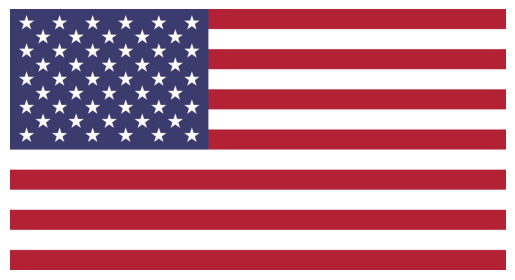

In [211]:
url = f'https://flagcdn.com/w2560/{flag_dict[p4]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [212]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: 4-square-fill
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p4}')+1)

'4th'

In [213]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p4].iloc[0])

{'value': 'Member'}

In [214]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p4].iloc[0])))

{'value': '12th'}

In [215]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p4].iloc[0])/1000}k")

{'value': '52046.0k'}

In [216]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p4].iloc[0])/1000}kg")

{'value': '32.0kg'}

In [217]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p4].iloc[0])))

{'value': '6th'}

## Column {width=7%}

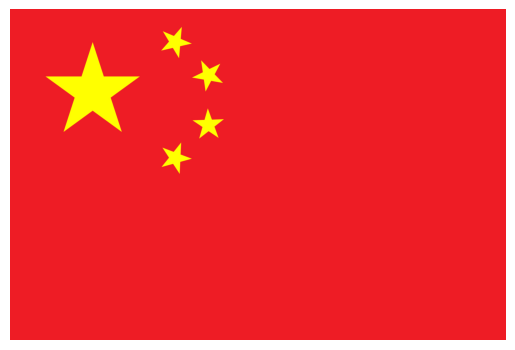

In [180]:
url = f'https://flagcdn.com/w2560/{flag_dict[p1]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [181]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p1}')+1)

'1st'

In [182]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p1].iloc[0])

{'value': 'Member'}

In [183]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p1].iloc[0])))

{'value': '33rd'}

In [184]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p1].iloc[0])/1000}k")

{'value': '231135.0k'}

In [185]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p1].iloc[0])/1000}kg")

{'value': '56.0kg'}

In [186]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p1].iloc[0])))

{'value': '32nd'}

## Column {width=7%}

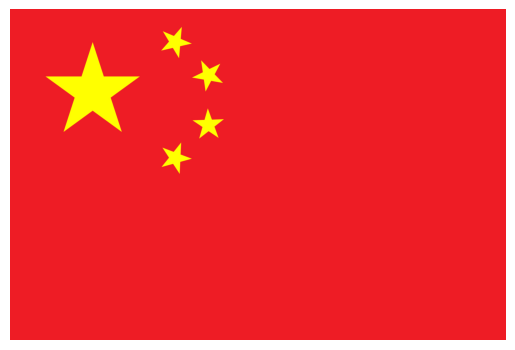

In [180]:
url = f'https://flagcdn.com/w2560/{flag_dict[p1]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [181]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p1}')+1)

'1st'

In [182]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p1].iloc[0])

{'value': 'Member'}

In [183]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p1].iloc[0])))

{'value': '33rd'}

In [184]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p1].iloc[0])/1000}k")

{'value': '231135.0k'}

In [185]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p1].iloc[0])/1000}kg")

{'value': '56.0kg'}

In [186]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p1].iloc[0])))

{'value': '32nd'}

## Column {width=7%}

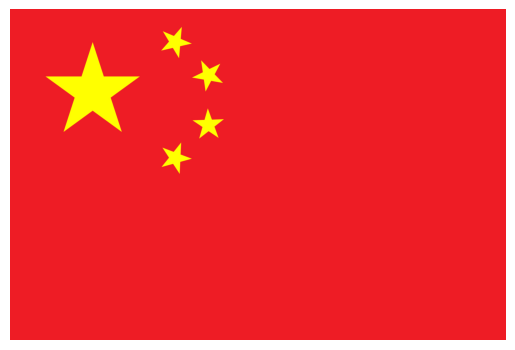

In [180]:
url = f'https://flagcdn.com/w2560/{flag_dict[p1]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [181]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p1}')+1)

'1st'

In [182]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p1].iloc[0])

{'value': 'Member'}

In [183]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p1].iloc[0])))

{'value': '33rd'}

In [184]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p1].iloc[0])/1000}k")

{'value': '231135.0k'}

In [185]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p1].iloc[0])/1000}kg")

{'value': '56.0kg'}

In [186]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p1].iloc[0])))

{'value': '32nd'}

## Column {width=7%}

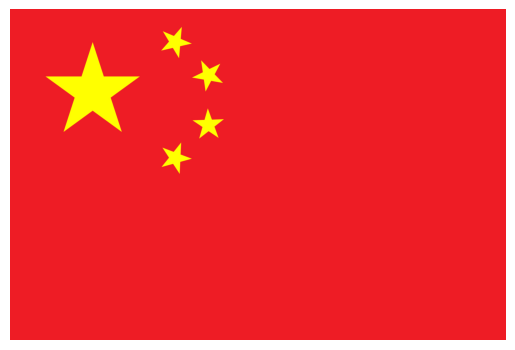

In [180]:
url = f'https://flagcdn.com/w2560/{flag_dict[p1]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [181]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p1}')+1)

'1st'

In [182]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p1].iloc[0])

{'value': 'Member'}

In [183]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p1].iloc[0])))

{'value': '33rd'}

In [184]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p1].iloc[0])/1000}k")

{'value': '231135.0k'}

In [185]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p1].iloc[0])/1000}kg")

{'value': '56.0kg'}

In [186]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p1].iloc[0])))

{'value': '32nd'}

## Column {width=7%}

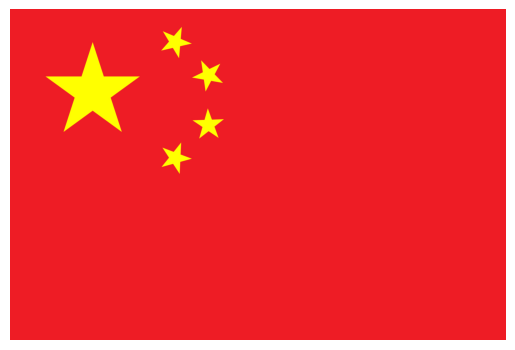

In [180]:
url = f'https://flagcdn.com/w2560/{flag_dict[p1]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [181]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p1}')+1)

'1st'

In [182]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p1].iloc[0])

{'value': 'Member'}

In [183]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p1].iloc[0])))

{'value': '33rd'}

In [184]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p1].iloc[0])/1000}k")

{'value': '231135.0k'}

In [185]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p1].iloc[0])/1000}kg")

{'value': '56.0kg'}

In [186]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p1].iloc[0])))

{'value': '32nd'}

## Column {width=7%}

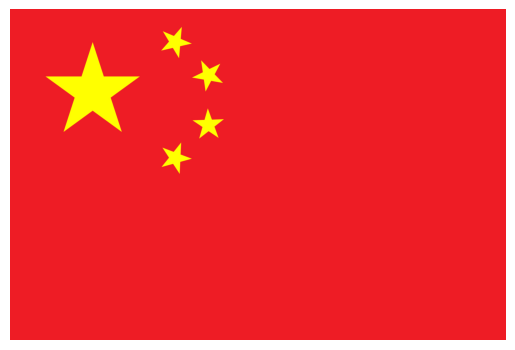

In [180]:
url = f'https://flagcdn.com/w2560/{flag_dict[p1]}.jpg'
response = requests.get(url, stream=True)
img = Image.open(response.raw)

plt.imshow(img)
plt.axis('off')
plt.show()

In [181]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p1}')+1)

'1st'

In [182]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p1].iloc[0])

{'value': 'Member'}

In [183]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p1].iloc[0])))

{'value': '33rd'}

In [184]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p1].iloc[0])/1000}k")

{'value': '231135.0k'}

In [185]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p1].iloc[0])/1000}kg")

{'value': '56.0kg'}

In [186]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p1].iloc[0])))

{'value': '32nd'}

# Analysis

## Row {height=50%}

In [64]:
# Load top 10 grain producers for last 10 years

with engine.connect() as connection:
    query = text('SELECT country AS Country, ROUND(AVG(value),2) AS Average_wheat_produced FROM grain_dash.wheat_production WHERE year > 2014 GROUP BY country ORDER BY Average_wheat_produced DESC LIMIT 10')
    result = connection.execute(query)
    top10_df = pd.DataFrame(result.all())

top10 = list(top10_df['Country'])

with engine.connect() as connection:
    query = text('SELECT country AS Country, ROUND(AVG(value*1000),2) AS Average_wheat_exported FROM grain_dash.wheat_export WHERE year > 2014 GROUP BY country ORDER BY FIELD(country, "China", "India", "Russian Federation", "United States", "France", "Canada", "Ukraine", "Pakistan", "Australia", "Germany")')
    result = connection.execute(query)
    export_df = pd.DataFrame(result.all())

export_df = export_df.tail(10).reset_index(drop=True)

balance_df = top10_df.merge(export_df, on='Country', how='inner')

balance_df['Average_wheat_exported'] = balance_df['Average_wheat_exported'].astype('float64')

fig2 = px.bar(balance_df, x = 'Country', y = ['Average_wheat_produced','Average_wheat_exported'], color = 'Country', text_auto=".2s", title="Average wheat produced /year since 2014 (tonnes)", barmode="overlay")

fig2 = fig2.update_layout(legend=dict(
        orientation="v",
        yanchor="bottom",
        y=0,
        xanchor="right",
        x=10,
        title_font_family="Courier",
            font=dict(
                family="Courier",
                size=12,
                color="black"
            ),
    ))

fig2.update_traces(textposition=['outside','inside'])

fig.update_layout(uniformtext_minsize=14, uniformtext_mode='hide')

fig2.update_layout(yaxis_title='')
fig2.update_layout(xaxis_title='')

fig2.update_layout(yaxis_range=[0,160000000])

fig2.show(renderer = "notebook")

## Row {height=50%}

### Column {width=20%}

In [32]:
#| content: valuebox
#| title: "Live Chicago wheat future price"
#| icon: graph-up-arrow
#| color: primary
dict(value = keusx_price)

{'value': 594.25}

### Column {width=80%}

In [23]:
wheat_prices = pd.read_csv(r'../data/wheat_prices/wheat_prices_FAO.csv')

wheat_prices.columns = ['Date','US (No. 2, Hard Red Winter)',
'Argentina (12%, Up River)',
'Australia (ASW)',
'Canada (CWRS, 13.5%)',
'France (grade 1, Rouen)',
'US (No. 2, Soft Red Winter)']

long_format_wp = pd.melt(wheat_prices, id_vars=['Date'], 
                         var_name='Country_Wheat_Type', 
                         value_name='Price')

sorted_wp = long_format_wp.sort_values(by = 'Date', ascending=False).reset_index(drop=True)

sorted_wp['Date'] = (pd.to_datetime(sorted_wp['Date'])).dt.date

resorted_wp = sorted_wp.sort_values(by='Date', ascending=False).reset_index(drop=True)

In [24]:
fig = px.line(resorted_wp, x = 'Date', y = 'Price', color = 'Country_Wheat_Type', title = 'Historic wheat prices')

fig = fig.update_layout(legend=dict(
        orientation="v",
        yanchor="bottom",
        y=0,
        xanchor="right",
        x=10,
        title_font_family="Courier",
            font=dict(
                family="Courier",
                size=8,
                color="black"
            ),
    ))
fig.show(renderer = "notebook")

# China

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [164]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p1}')+1)

'1st'

In [163]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p1].iloc[0])

{'value': 'Member'}

In [162]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p1].iloc[0])))

{'value': '33rd'}

## Column {width=10%}

In [161]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p1].iloc[0])/1000}k")

{'value': '231135.0k'}

In [160]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p1].iloc[0])/1000}kg")

{'value': '56.0kg'}

In [159]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p1].iloc[0])))

{'value': '32nd'}

## Column {width=50%}

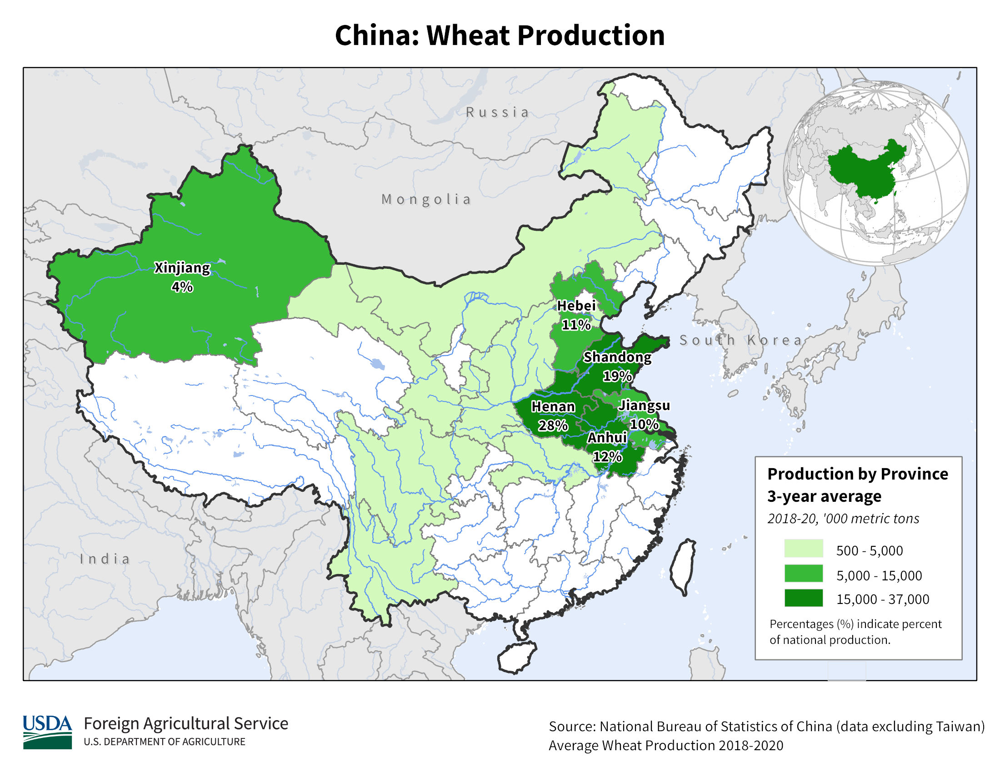

# India

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [158]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p2}')+1)

'2nd'

In [157]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p2].iloc[0])

{'value': 'Member'}

In [156]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p2].iloc[0])))

{'value': '5th'}

## Column {width=10%}

In [155]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p2].iloc[0])/1000}k")

{'value': '16213.0k'}

In [154]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p2].iloc[0])/1000}kg")

{'value': '33.0kg'}

In [153]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p2].iloc[0])))

{'value': '62nd'}

## Column {width=50%}

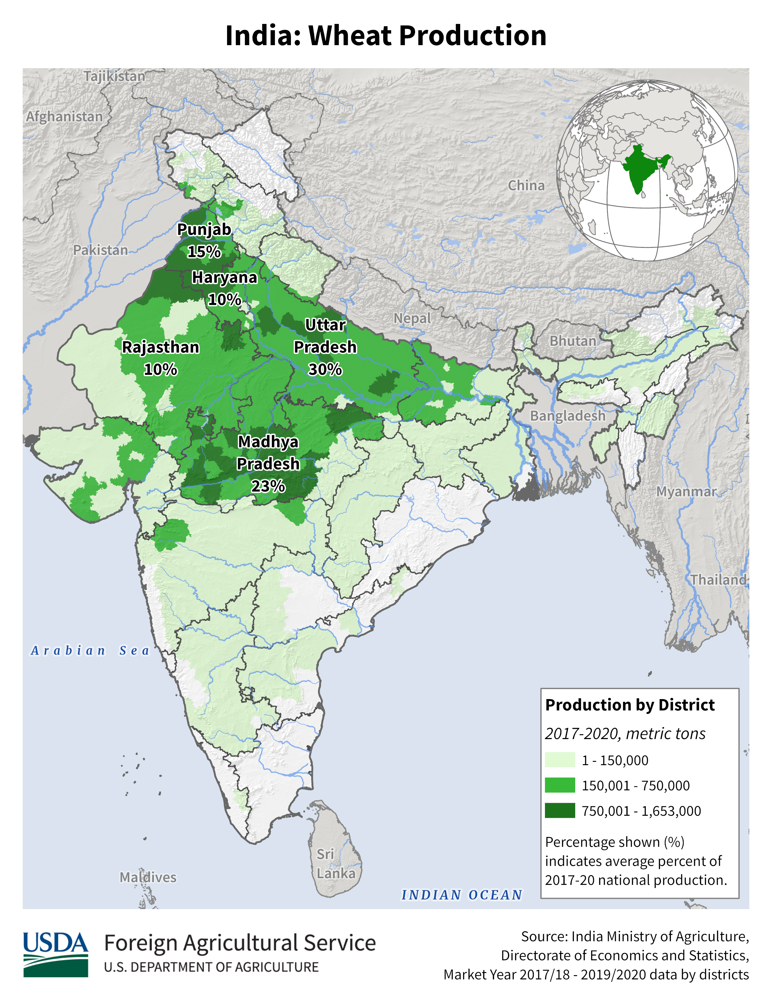

# Russia

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [152]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p3}')+1)

'3rd'

In [151]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p3].iloc[0])

{'value': 'Member'}

In [149]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p3].iloc[0])))

{'value': '79th'}

## Column {width=10%}

In [148]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p3].iloc[0])/1000}k")

{'value': '4477.0k'}

In [147]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p3].iloc[0])/1000}kg")

{'value': '29.0kg'}

In [146]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p3].iloc[0])))

{'value': '29th'}

## Column {width=50%}

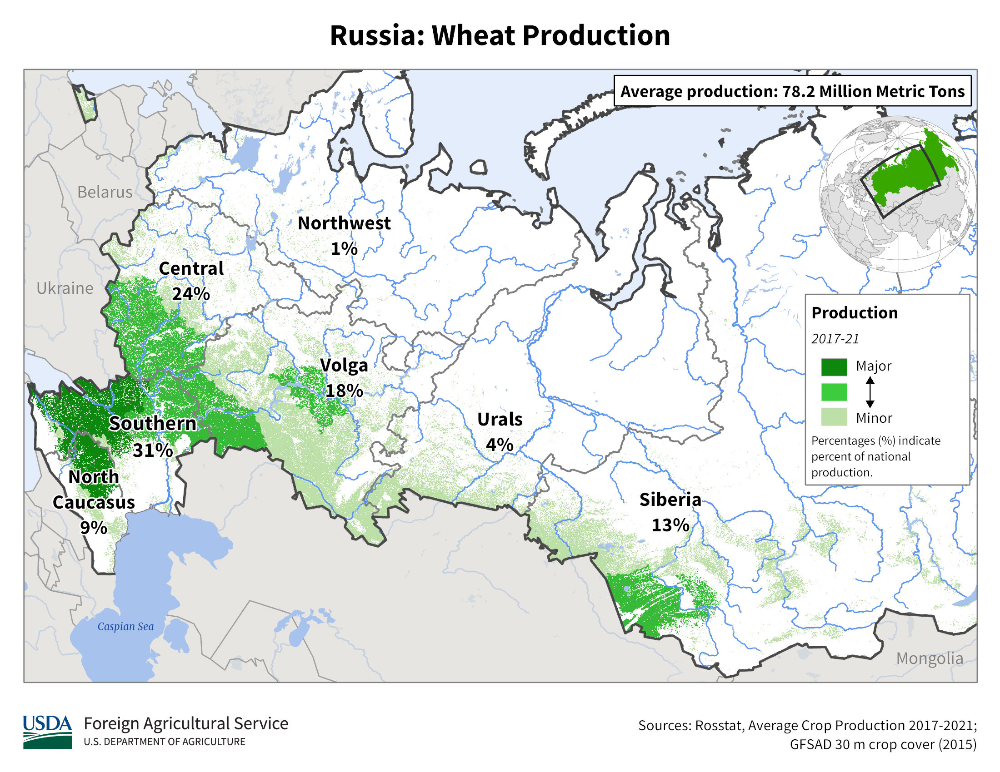

# United States

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [145]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p4}')+1)

'4th'

In [144]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p4].iloc[0])

{'value': 'Member'}

In [143]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p4].iloc[0])))

{'value': '12th'}

## Column {width=10%}

In [142]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p4].iloc[0])/1000}k")

{'value': '52046.0k'}

In [141]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p4].iloc[0])/1000}kg")

{'value': '32.0kg'}

In [140]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p4].iloc[0])))

{'value': '6th'}

## Column {width=50%}

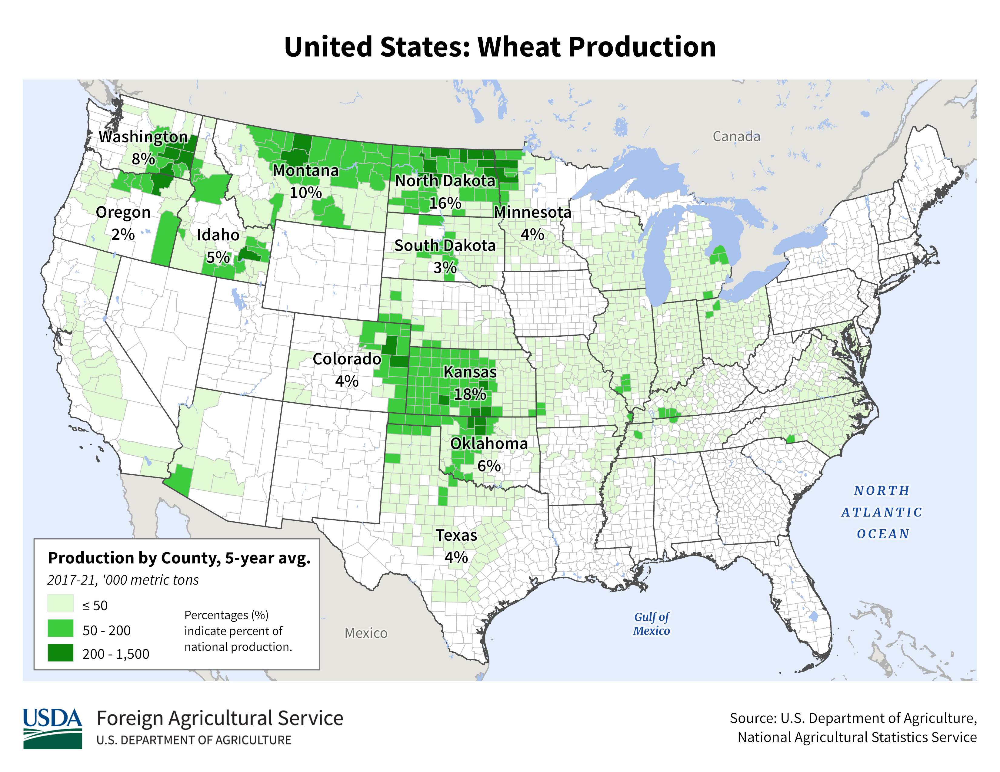

# France

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [134]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p5}')+1)

'5th'

In [135]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p5].iloc[0])

{'value': 'Member'}

In [136]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p5].iloc[0])))

{'value': '34th'}

## Column {width=10%}

In [137]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p5].iloc[0])/1000}k")

{'value': '4843.0k'}

In [138]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p5].iloc[0])/1000}kg")

{'value': '69.0kg'}

In [139]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p5].iloc[0])))

{'value': '33rd'}

## Column {width=50%}

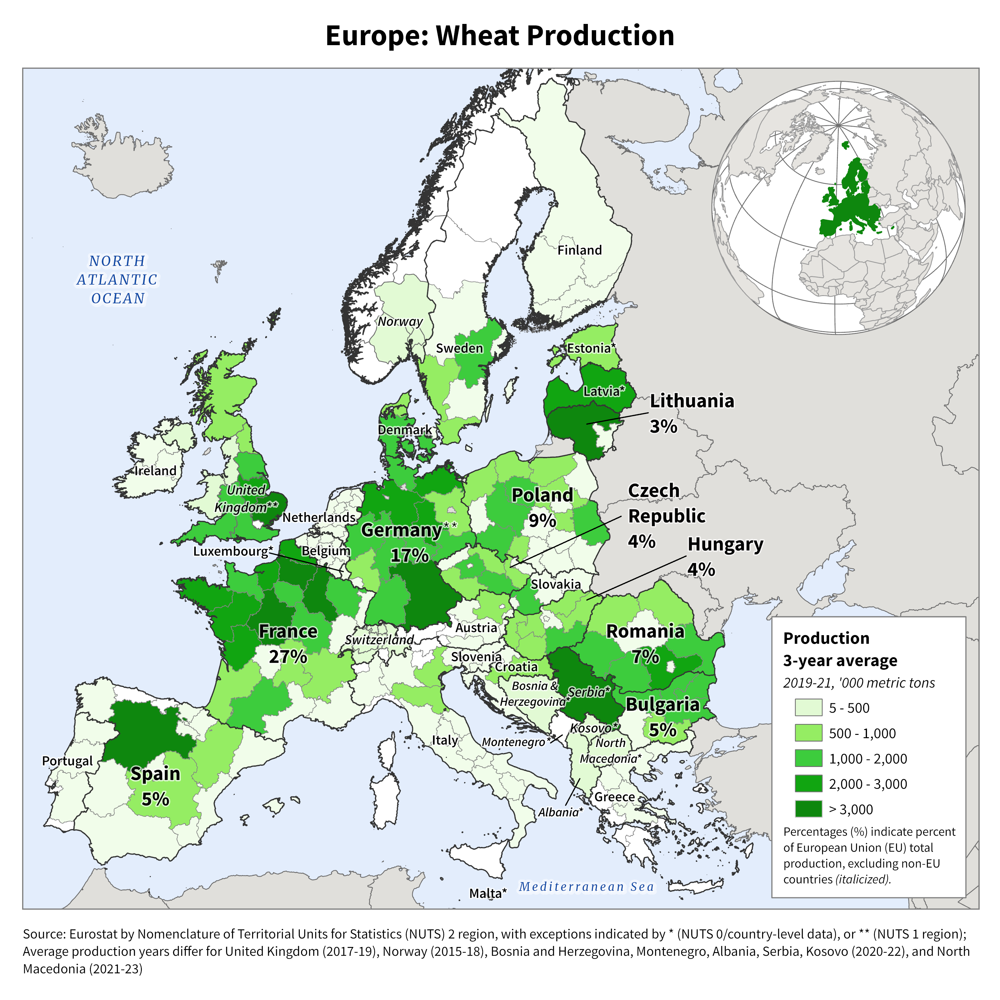

# Canada

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [127]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p6}')+1)

'6th'

In [126]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p6].iloc[0])

{'value': 'Member'}

In [125]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p6].iloc[0])))

{'value': '9th'}

## Column {width=10%}

In [124]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p6].iloc[0])/1000}k")

{'value': '6452.0k'}

In [123]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p6].iloc[0])/1000}kg")

{'value': '32.0kg'}

In [122]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p6].iloc[0])))

{'value': '23rd'}

## Column {width=50%}

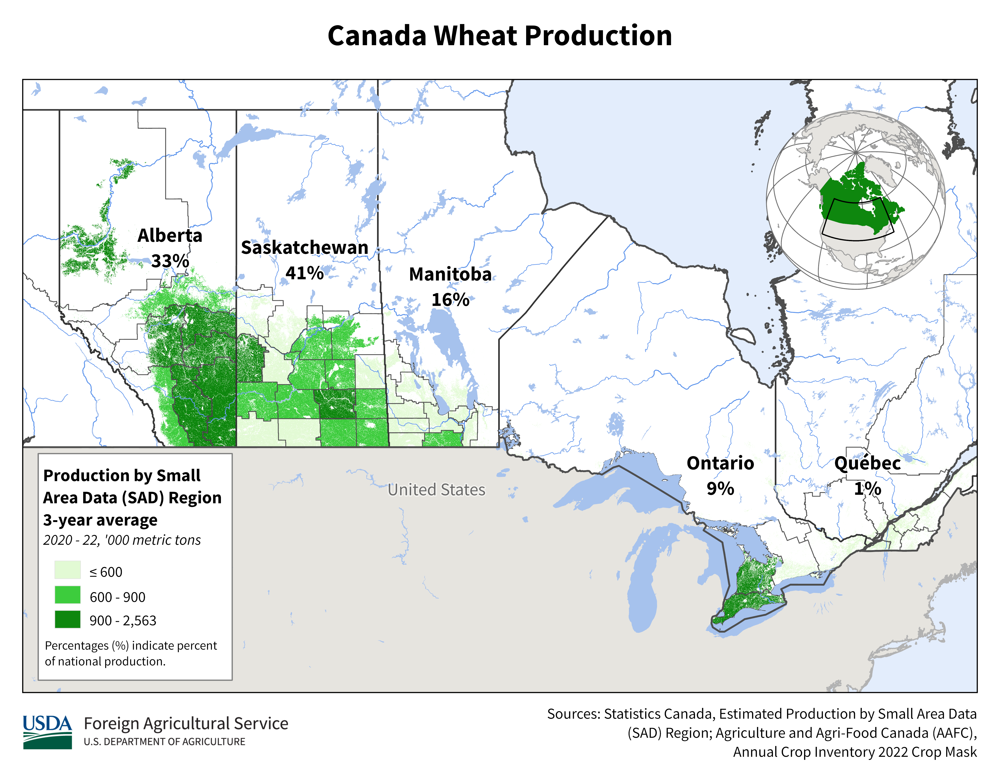

# Ukraine

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [133]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p7}')+1)

'7th'

In [132]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p7].iloc[0])

{'value': 'Member'}

In [131]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p7].iloc[0])))

{'value': '121st'}

## Column {width=10%}

In [130]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p7].iloc[0])/1000}k")

{'value': '830.0k'}

In [129]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p7].iloc[0])/1000}kg")

{'value': '40.0kg'}

In [128]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p7].iloc[0])))

{'value': '64th'}

## Column {width=50%}

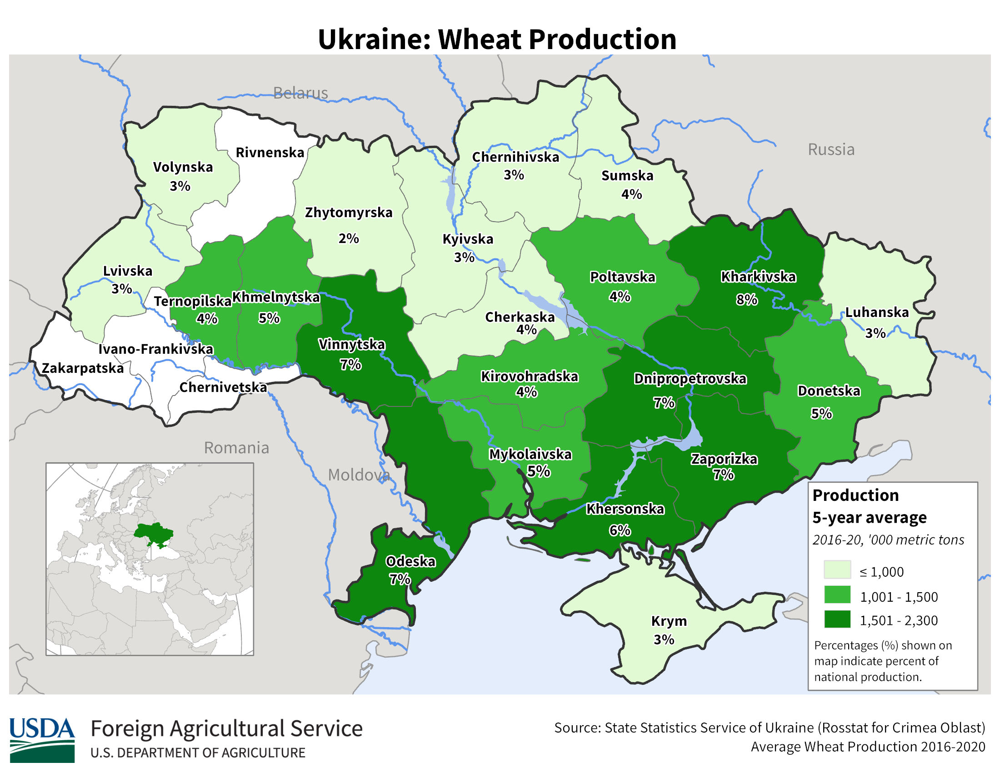

# Pakistan

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [81]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p8}')+1)

'8th'

In [82]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p8].iloc[0])

{'value': 'Member'}

In [120]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p8].iloc[0])))

{'value': '100th'}

## Column {width=10%}

In [84]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p8].iloc[0])/1000}k")

{'value': '3167.0k'}

In [85]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p8].iloc[0])/1000}kg")

{'value': '29.0kg'}

In [93]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p8].iloc[0])))

{'value': '108th'}

## Column {width=50%}

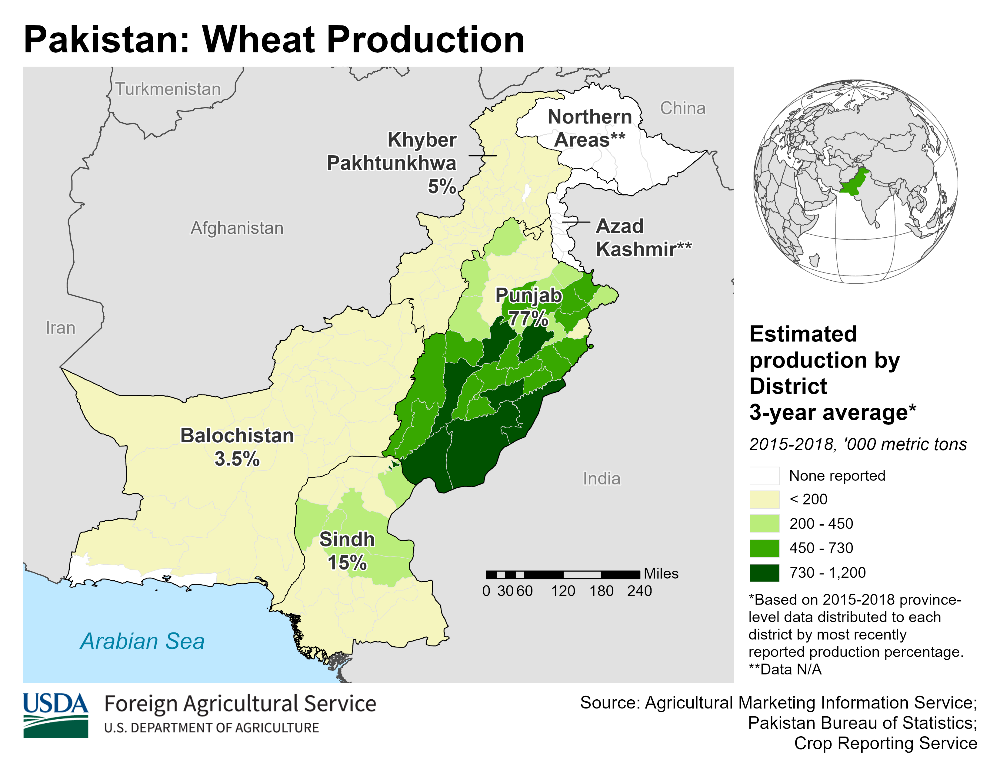

# Australia

## Column {width=10%}

In [68]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [18]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p9}')+1)

'9th'

In [19]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p9].iloc[0])

{'value': 'Member'}

In [119]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p9].iloc[0])))

{'value': '43rd'}

## Column {width=10%}

In [69]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p9].iloc[0])/1000}k")

{'value': '8227.0k'}

In [22]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p9].iloc[0])/1000}kg")

{'value': '21.0kg'}

In [91]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p9].iloc[0])))

{'value': '14th'}

## Column {width=50%}

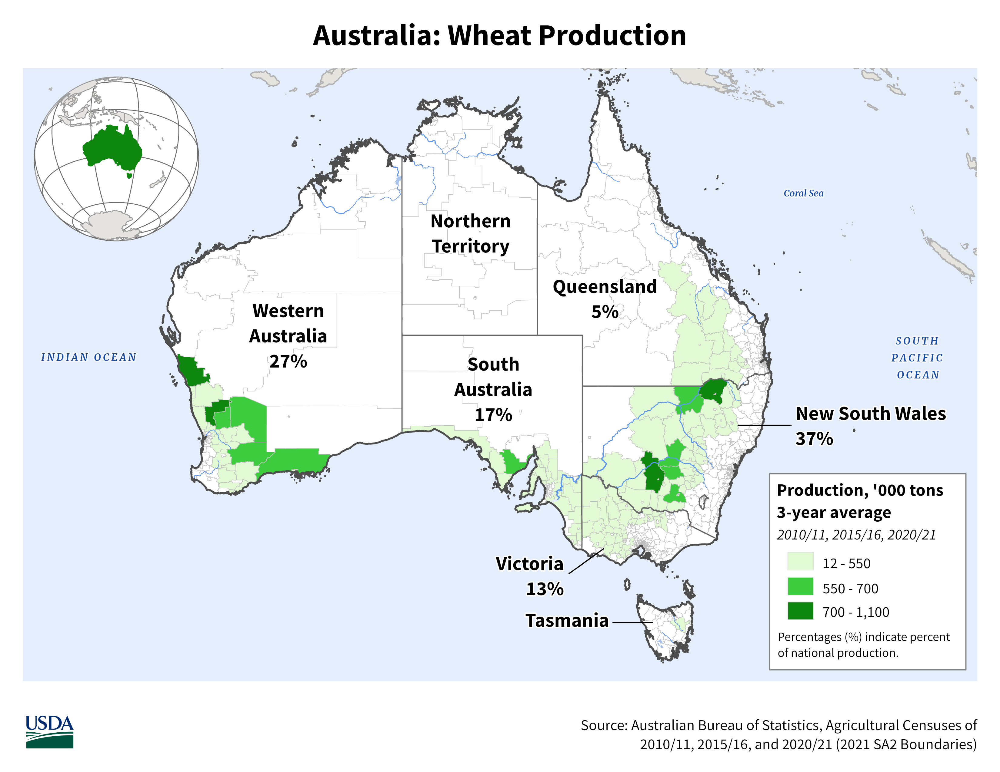

# Germany

## Column {width=10%}

In [72]:
# url = f'https://flagcdn.com/w2560/{flag_dict[p9]}.jpg'
# response = requests.get(url, stream=True)
# img = Image.open(response.raw)

# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [73]:
#| content: valuebox
#| title: "Global Wheat Production"
#| icon: globe-europe-africa
#| color: success
# dict(value = keusx_price)
ordinal(top10.index(f'{p10}')+1)

'10th'

In [74]:
#| content: valuebox
#| title: "WTO member status"
#| icon: globe
#| color: info
dict(value = wto_df['status'][wto_df['country']== p10].iloc[0])

{'value': 'Member'}

In [118]:
#| content: valuebox
#| title: "Climate risk ranking"
#| icon: sun
#| color: danger
dict(value = ordinal(int(climate_df['index_rank'][climate_df['country']== p10].iloc[0])))

{'value': '3rd'}

## Column {width=10%}

In [76]:
#| content: valuebox
#| title: "Shipping containers/year"
#| icon: truck
#| color: dark
dict(value = f"{int(container_df['Average_container_traffic'][container_df['Country'] == p10].iloc[0])/1000}k")

{'value': '14876.0k'}

In [77]:
#| content: valuebox
#| title: "Crop yield (kg/hectare)"
#| icon: graph-up-arrow
#| color: warning
dict(value = f"{int(yield_df['Average_yield'][yield_df['Country'] == p10].iloc[0])/1000}kg")

{'value': '75.0kg'}

In [92]:
#| content: valuebox
#| title: "Doing Business ranking"
#| icon: building-add
#| color: light
dict(value = ordinal(int(db_df['db_rank'][db_df['country'] == p10].iloc[0])))

{'value': '22nd'}

## Column {width=50%}

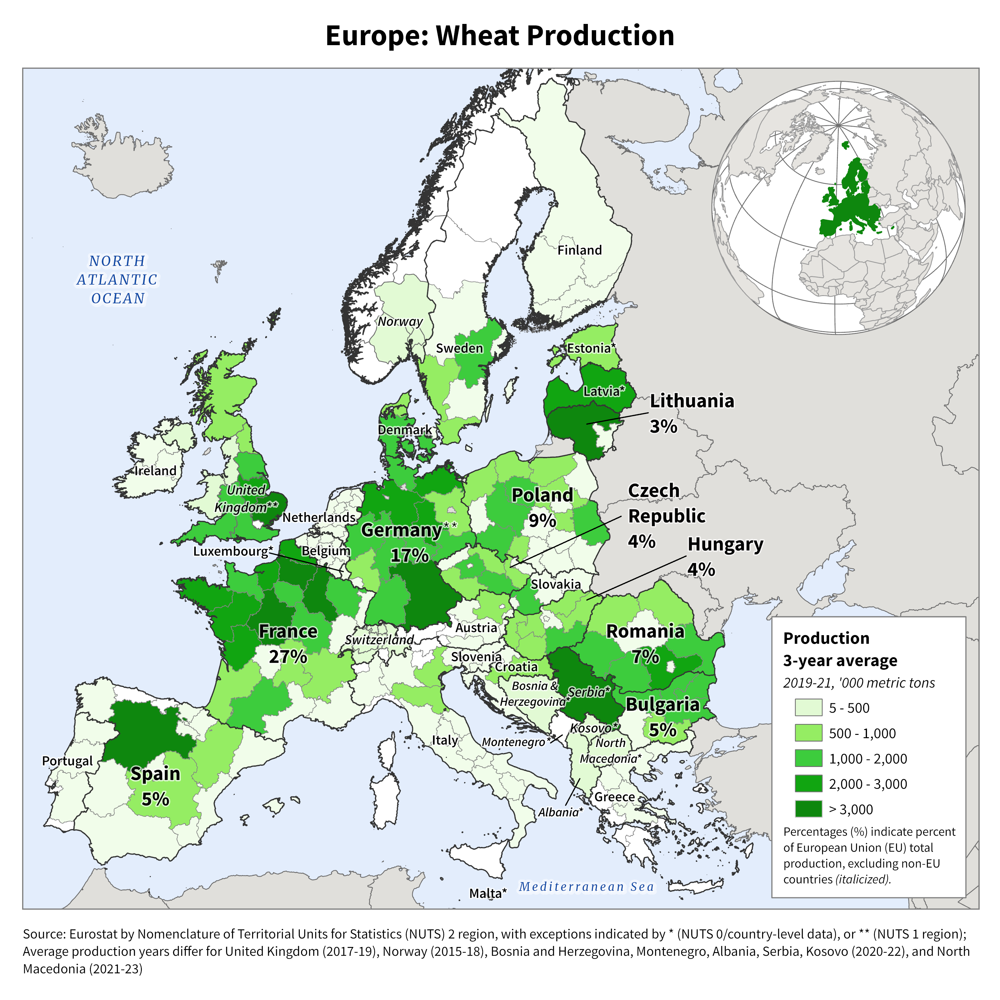